In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
from collections import Counter
import pydicom
import cv2
import seaborn as sns
import torch
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import torchvision

import warnings
warnings.filterwarnings("ignore")

In [2]:
train = pd.read_csv('/kaggle/input/completed-dataset/train_data.csv')

+ UNK: Unknown, bệnh lý không rõ ràng
+ NV: Nevus, nốt ruồi
+ MEL: Melanoma, một dạng ung thư da ác tính xuất phát từ các tế bào sắc tố (melanocytes)
+ BKL: Benign Keratosis-like Lesions, một số loại tổn thương da lành tính có đặc điểm tương tự như keratosis. BKL bao gồm "seborrheic keratosis", "lentigo NOS", "lichenoid keratosis", và "solar lentigo". Các loại tổn thương này thường không gây nguy hiểm nhưng có thể gây nhầm lẫn với các loại tổn thương ác tính khác nếu không được kiểm tra kỹ lưỡng.

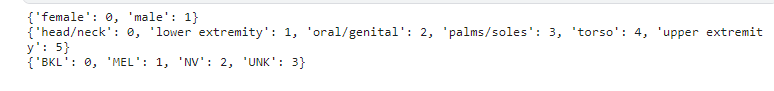

In [3]:
train.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,path_jpeg,path_dicom
0,ISIC_0237862,IP_5752342,1,75.0,5,3,../input/siim-isic-melanoma-classification/jpe...,../input/siim-isic-melanoma-classification/tra...
1,ISIC_5229249,IP_0093378,1,50.0,4,3,../input/siim-isic-melanoma-classification/jpe...,../input/siim-isic-melanoma-classification/tra...
2,ISIC_9740742,IP_5176722,1,60.0,1,2,../input/siim-isic-melanoma-classification/jpe...,../input/siim-isic-melanoma-classification/tra...
3,ISIC_1285997,IP_8524154,1,60.0,4,3,../input/siim-isic-melanoma-classification/jpe...,../input/siim-isic-melanoma-classification/tra...
4,ISIC_1142933,IP_0857646,1,60.0,0,3,../input/siim-isic-melanoma-classification/jpe...,../input/siim-isic-melanoma-classification/tra...


# FILE DICOM


In [4]:
def show_images_dicom(data, n = 5, rows=1, cols=5, title='Default'):
    plt.figure(figsize=(16,4))

    for k, path in enumerate(data['path_dicom'][:n]):
        image = pydicom.read_file(path)
        image = image.pixel_array
        
        # image = resize(image, (200, 200), anti_aliasing=True)

        plt.suptitle(title, fontsize = 16)
        plt.subplot(rows, cols, k+1)
        plt.imshow(image)
        plt.axis('off')

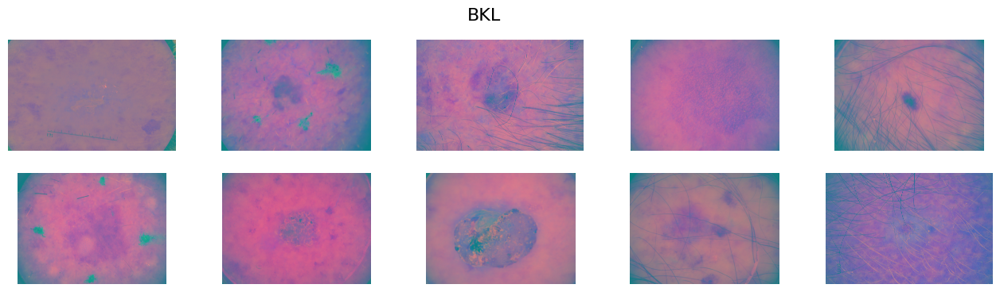

In [5]:
show_images_dicom(train[train['diagnosis'] == 0], n=10, rows=2, cols=5, title='BKL')

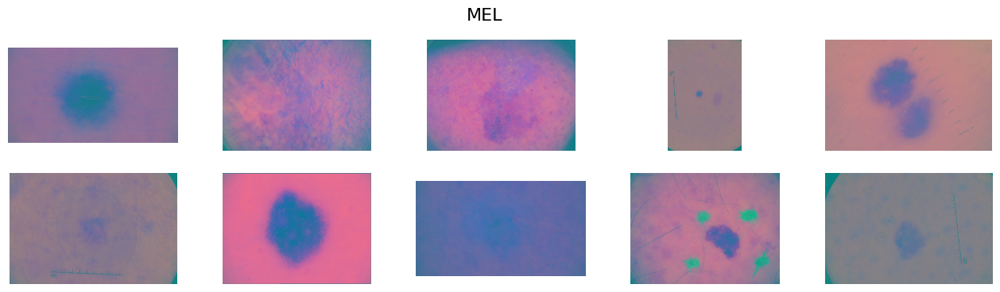

In [6]:
show_images_dicom(train[train['diagnosis'] == 1], n=10, rows=2, cols=5, title='MEL')

# PROBLEM

1: Different skin tones

2: Different lightings in the image

3: Different sizes of the images

# 1. B&W VIEW


In [7]:
def plot_bw_images(train_df, title="B&W"):
    """
    This function returns images in black and white from a DICOM file.
    """
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
    plt.suptitle(title, fontsize=16)

    for i in range(12):
        data = pydicom.read_file(train_df['path_dicom'][i])
        image = data.pixel_array

        # Chuyển hình ảnh sang đen trắng
        image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        image = cv2.resize(image, (200,200))

        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone)
        axes[x, y].axis('off')

    plt.show()

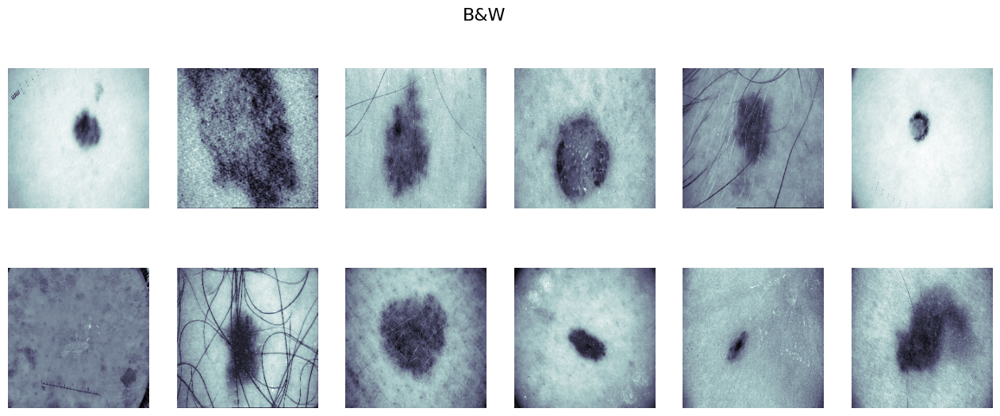

In [8]:
plot_bw_images(train, title="B&W")

# 2.  Ben Graham: greyscale + Gaussian Blu

# 2.1. HSV color space (Without Gaussian Blur)

In [12]:
def plot_hsv_images(train_df, title="Without Gaussian Blur"):
    """
    This function displays images in HSV color space from DICOM files.

    """
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
    plt.suptitle(title, fontsize=16)

    for i in range(12):  
        data = pydicom.read_file(train_df['path_dicom'][i])
        image = data.pixel_array

        # Convert to HSV color space and resize
        image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        image = cv2.resize(image, (200,200))

        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone)
        axes[x, y].axis('off')

    plt.show()

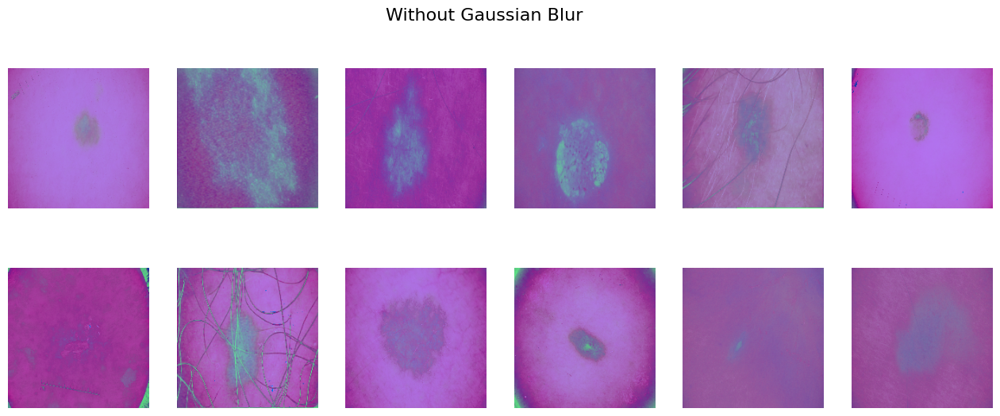

In [13]:
plot_hsv_images(train, title="Without Gaussian Blur")

# 2.2. With Gaussian Blur

In [14]:
def plot_blurred_images(train_df, title="With Gaussian Blur"):
    """
   This function displays images with Gaussian Blur and unsharp masking from DICOM files.
    """
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
    plt.suptitle(title, fontsize=16)

    for i in range(12):
        data = pydicom.read_file(train_df['path_dicom'][i])
        image = data.pixel_array

        # Convert the image to RGB (if not already in that format)
        image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        image = cv2.resize(image, (200,200))
        
        # Apply Gaussian Blur and unsharp masking
        blurred_image = cv2.GaussianBlur(image, (0,0), 256/10)
        image = cv2.addWeighted(image, 4, blurred_image, -4, 128)

        x = i // 6
        y = i % 6
        axes[x, y].imshow(image)
        axes[x, y].axis('off')

    plt.show()

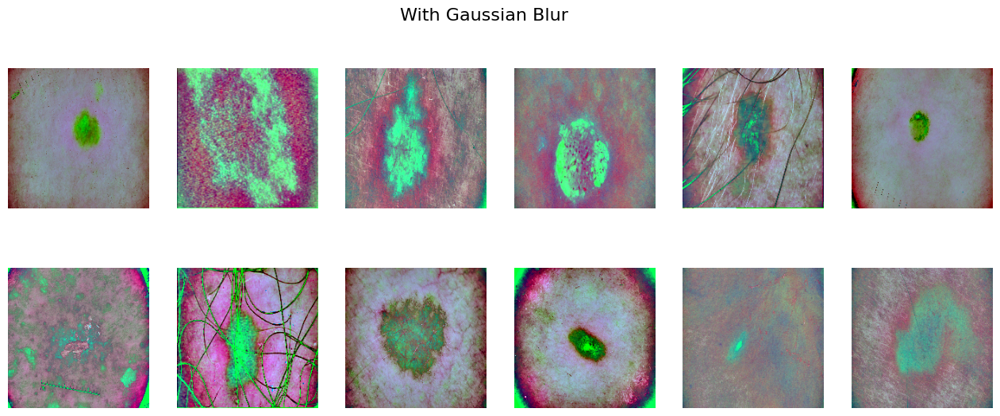

In [15]:
plot_blurred_images(train, title="With Gaussian Blur")

# 2.3. Hue, Saturation, Brightness

In [16]:
def plot_hls_images(train_df, title="Hue, Saturation, Lightness"):
    """
    This function displays images converted to HLS color space from DICOM files.
    """
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
    plt.suptitle(title, fontsize=16)

    for i in range(12):  
        data = pydicom.read_file(train_df['path_dicom'][i])
        image = data.pixel_array

        image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        image = cv2.resize(image, (200,200))

        x = i // 6
        y = i % 6
        axes[x, y].imshow(image) 
        axes[x, y].axis('off')

    plt.show()

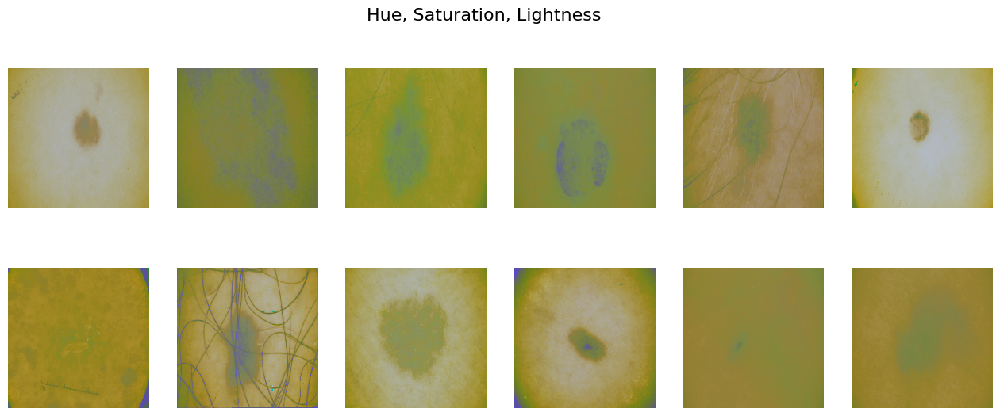

In [17]:
plot_hls_images(train, title="Hue, Saturation, Lightness")

# 2.4. LUV Color Space 

In [18]:
def plot_luv_images(train_df, title="LUV Color Space"):
    """
    This function displays images converted to the LUV color space from DICOM files.
    """
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
    plt.suptitle(title, fontsize=16)

    for i in range(12):  
        data = pydicom.read_file(train_df['path_dicom'][i])
        image = data.pixel_array

        # Convert the image to LUV color space and resize
        image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
        image = cv2.resize(image, (200,200))

        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone)
        axes[x, y].axis('off')

    plt.show()


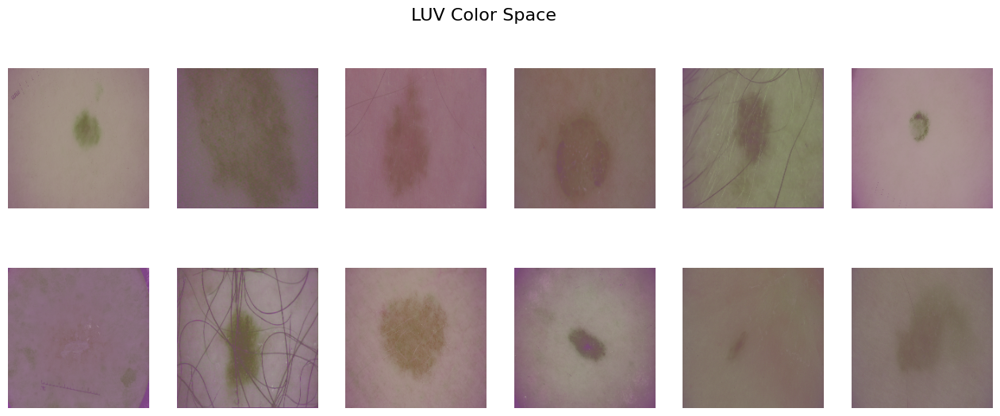

In [19]:
plot_luv_images(train, title="LUV Color Space")

# FILE JPEG

In [20]:
def show_images_jpeg(data, n = 5, rows=1, cols=5, title='Default'):
    plt.figure(figsize=(16,6))

    for k, path in enumerate(data['path_jpeg'][:n]):
        image = mpimg.imread(path)
        
        # image = resize(image, (200, 200), anti_aliasing=True)

        plt.suptitle(title, fontsize = 16)
        plt.subplot(rows, cols, k+1)
        plt.imshow(image)
        plt.axis('off')

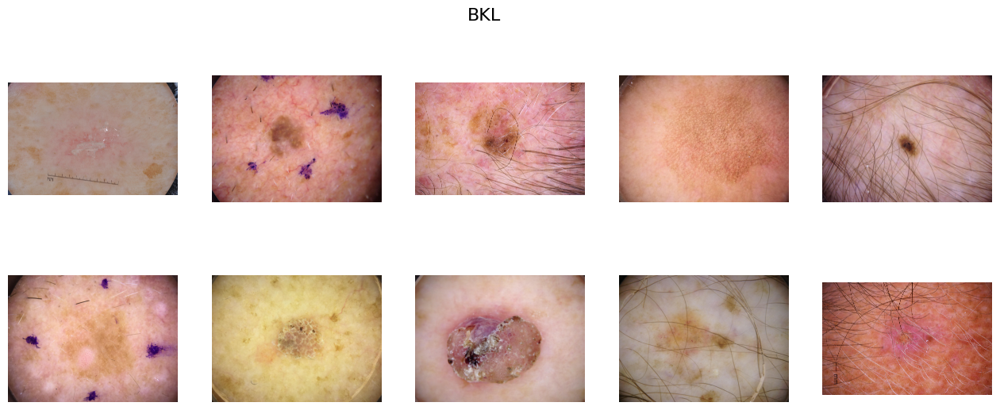

In [21]:
show_images_jpeg(train[train['diagnosis'] == 0], n=10, rows=2, cols=5, title='BKL')

# 1. Torchvision.transforms

In [22]:
class DatasetNew(Dataset):
    def __init__(self, image_list, transforms=None):
        self.image_list = image_list
        self.transforms = transforms
    
    def __len__(self):
        return (len(self.image_list))
    
    def __getitem__(self, i):
        image = plt.imread(self.image_list[i])
        image = Image.fromarray(image).convert('RGB')        
        image = np.asarray(image).astype(np.uint8)
        if self.transforms is not None:
            image = self.transforms(image)
            
        return torch.tensor(image, dtype=torch.float)

In [23]:
def show_transform(image, title="Default"):
    plt.figure(figsize=(16,6))
    plt.suptitle(title, fontsize = 16)
    
    image = image / 2 + 0.5  
    npimg = image.numpy()
    npimg = np.clip(npimg, 0., 1.)
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# 1.1. CROP

In [24]:
def process_images_1(image_list, batch_size=12, show_title="Crop"):
    transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((300, 300)),
        transforms.CenterCrop((100, 100)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])

    pytorch_dataset = DatasetNew(image_list=image_list, transforms=transform)
    pytorch_dataloader = DataLoader(dataset=pytorch_dataset, batch_size=batch_size, shuffle=True)

    images = next(iter(pytorch_dataloader))

    show_transform(torchvision.utils.make_grid(images, nrow=6), title=show_title)


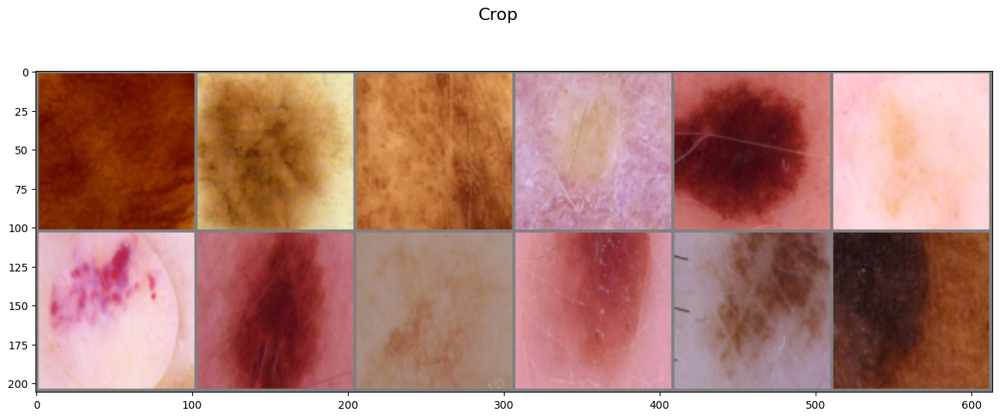

In [25]:
image_list = train.sample(12)['path_jpeg']
image_list = image_list.reset_index()['path_jpeg']

process_images_1(image_list, batch_size=12, show_title="Crop")

# 1.2. Color Jitter

In [26]:
def process_images_2(image_list, batch_size=12, show_title="Crop"):
    
    transform = transforms.Compose([
         transforms.ToPILImage(),
         transforms.Resize((300, 300)),
         transforms.ColorJitter(brightness=0.7, contrast=0.7, saturation=0.7, hue=0.5),
         transforms.ToTensor(),
         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
     ])

    pytorch_dataset = DatasetNew(image_list=image_list, transforms=transform)
    pytorch_dataloader = DataLoader(dataset=pytorch_dataset, batch_size=batch_size, shuffle=True)

    images = next(iter(pytorch_dataloader))

    show_transform(torchvision.utils.make_grid(images, nrow=6), title=show_title)


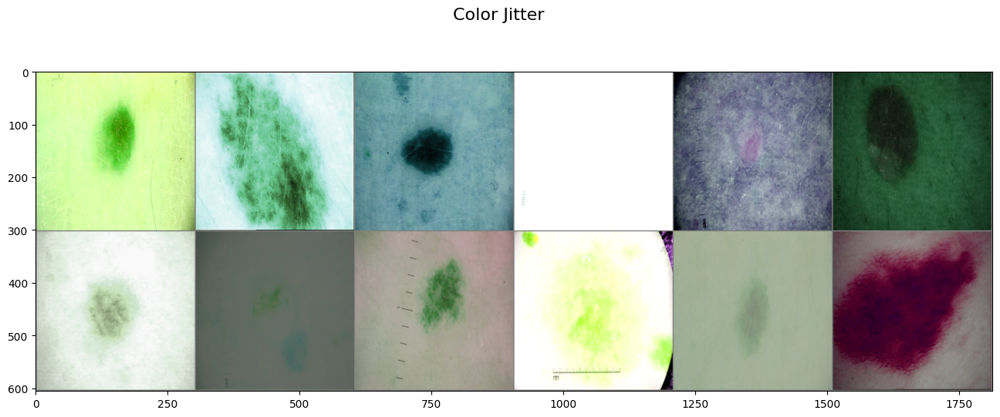

In [27]:
process_images_2(image_list, batch_size=12, show_title="Color Jitter")

# 1.3. RandomGreyscal

In [28]:
def process_images_3(image_list, batch_size=12, show_title="Crop"):
    
    transform = transforms.Compose([
         transforms.ToPILImage(),
         transforms.Resize((300, 300)),
         transforms.RandomGrayscale(p=0.7),
         transforms.ToTensor(),
         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
     ])

    pytorch_dataset = DatasetNew(image_list=image_list, transforms=transform)
    pytorch_dataloader = DataLoader(dataset=pytorch_dataset, batch_size=batch_size, shuffle=True)

    images = next(iter(pytorch_dataloader))

    show_transform(torchvision.utils.make_grid(images, nrow=6), title=show_title)


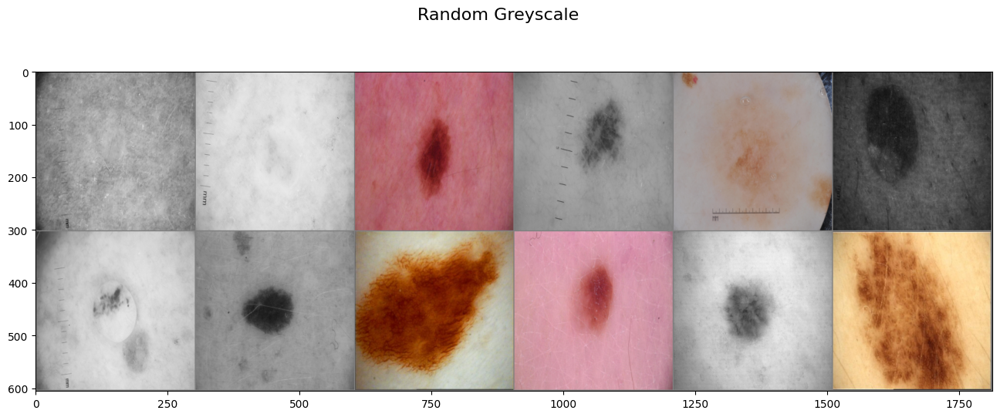

In [29]:
process_images_3(image_list, batch_size=12, show_title="Random Greyscale")

 # 1.4. RandomVerticalFlip

In [30]:
def process_images_4(image_list, batch_size=12, show_title="Crop"):
    
    transform = transforms.Compose([
         transforms.ToPILImage(),
         transforms.Resize((300, 300)),
         transforms.RandomVerticalFlip(p=0.7),
         transforms.ToTensor(),
         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
     ])


    pytorch_dataset = DatasetNew(image_list=image_list, transforms=transform)
    pytorch_dataloader = DataLoader(dataset=pytorch_dataset, batch_size=batch_size, shuffle=True)

    images = next(iter(pytorch_dataloader))

    show_transform(torchvision.utils.make_grid(images, nrow=6), title=show_title)


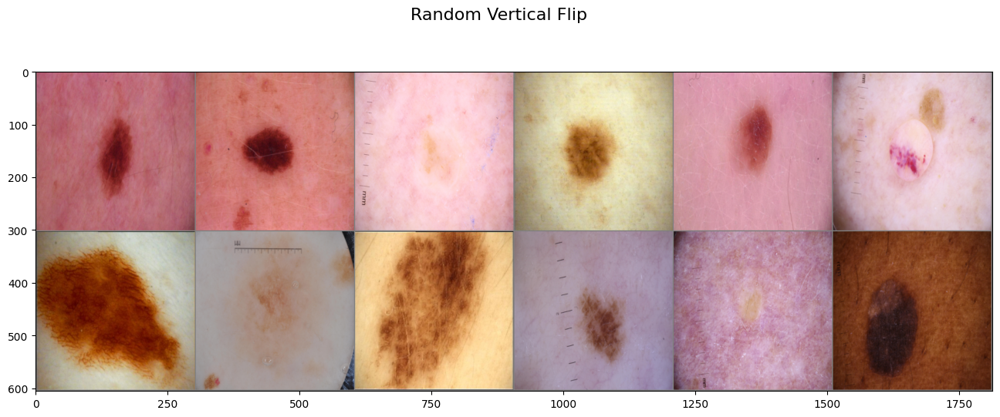

In [31]:
process_images_4(image_list, batch_size=12, show_title="Random Vertical Flip")

# 2. Hair Remove

In [32]:
image_list1 = train['path_jpeg'].sample(8).tolist()

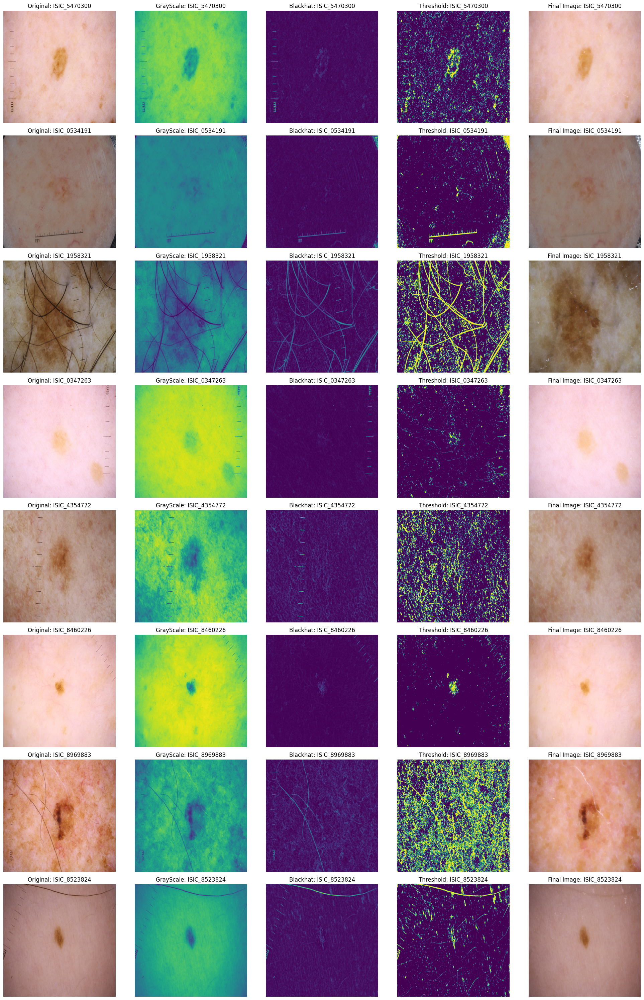

In [33]:
# Tạo subplot
l = len(image_list1)
fig = plt.figure(figsize=(20, 30))

# Lặp qua từng ảnh trong danh sách ảnh
for i, image_path in enumerate(image_list1):
    image_name = train.loc[train['path_jpeg'] == image_path, 'image_name'].iloc[0]
    image = cv2.imread(image_path)
    image_resize = cv2.resize(image, (1024, 1024))
    
    # Hiển thị ảnh gốc
    plt.subplot(l, 5, (i * 5) + 1)
    plt.imshow(cv2.cvtColor(image_resize, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Original: ' + image_name)
    
    # Chuyển đổi thành ảnh grayscale
    grayScale = cv2.cvtColor(image_resize, cv2.COLOR_RGB2GRAY)
    plt.subplot(l, 5, (i * 5) + 2)
    plt.imshow(grayScale)
    plt.axis('off')
    plt.title('GrayScale: ' + image_name)
    
    # Kernel cho việc lọc hình thái học
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (17, 17))
    
    # Thực hiện blackHat filtering để tìm contour của tóc
    blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    plt.subplot(l, 5, (i * 5) + 3)
    plt.imshow(blackhat)
    plt.axis('off')
    plt.title('Blackhat: ' + image_name)
    
    # Tăng cường contour của tóc để chuẩn bị cho việc inpainting
    ret, threshold = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    plt.subplot(l, 5, (i * 5) + 4)
    plt.imshow(threshold)
    plt.axis('off')
    plt.title('Threshold: ' + image_name)
    
    # Inpainting ảnh gốc dựa trên mặt nạ đã tạo
    final_image = cv2.inpaint(image_resize, threshold, 1, cv2.INPAINT_TELEA)
    plt.subplot(l, 5, (i * 5) + 5)
    plt.imshow(cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Final Image: ' + image_name)

plt.tight_layout()
plt.show()


In [34]:
def remove_hair(image):
    grayScale = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    kernel = cv2.getStructuringElement(1,(17,17))
    
    blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    
    _,threshold = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
    
    final_image = cv2.inpaint(image,threshold,1,cv2.INPAINT_TELEA)
    
    return final_image

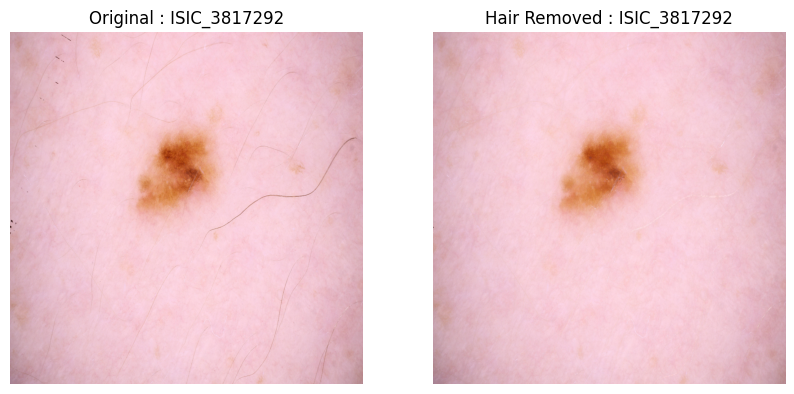

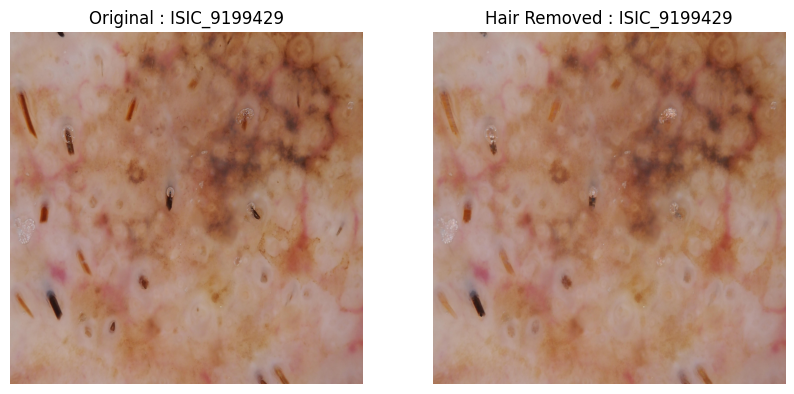

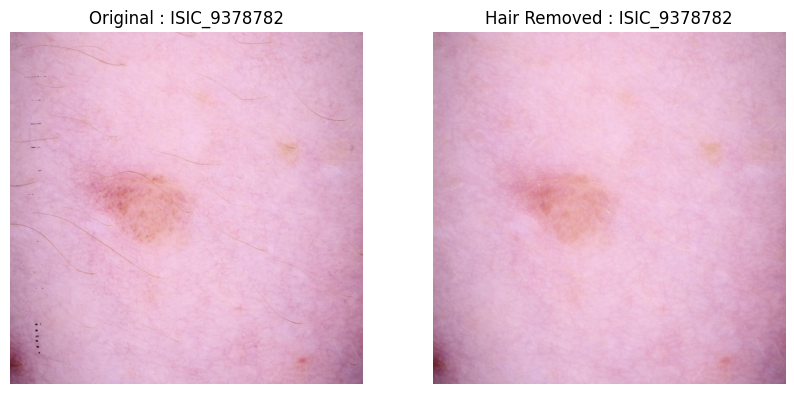

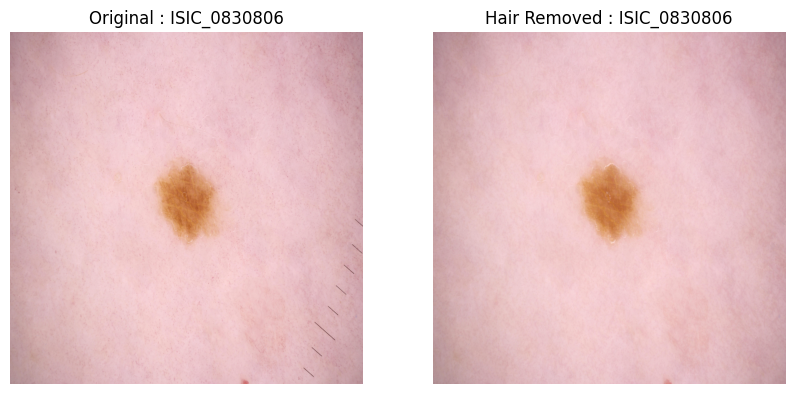

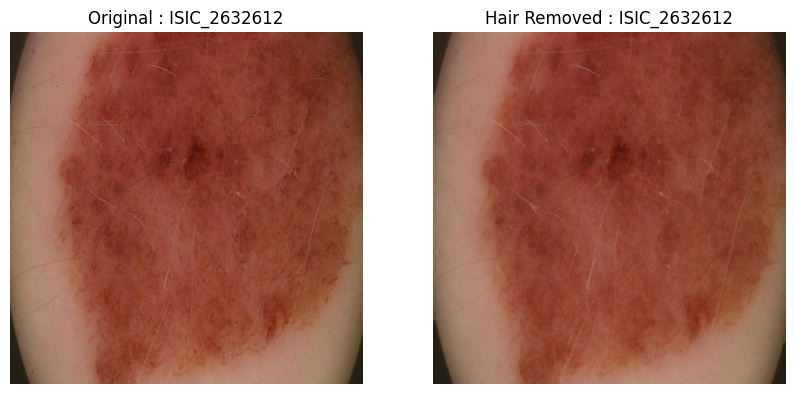

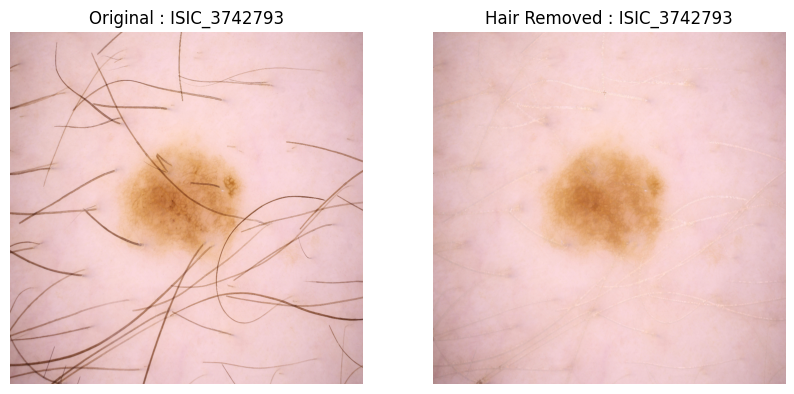

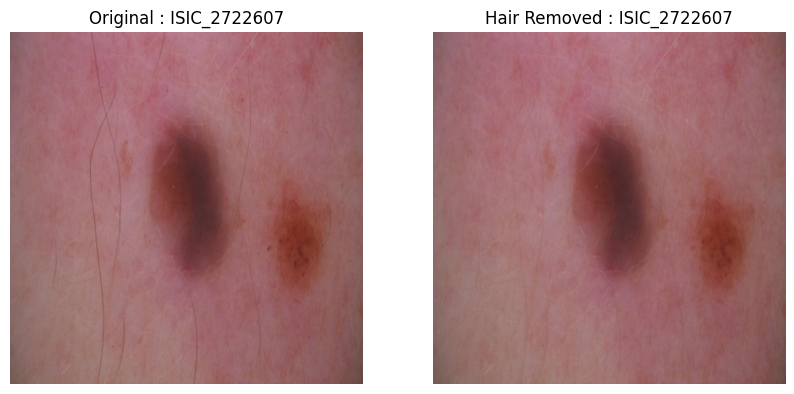

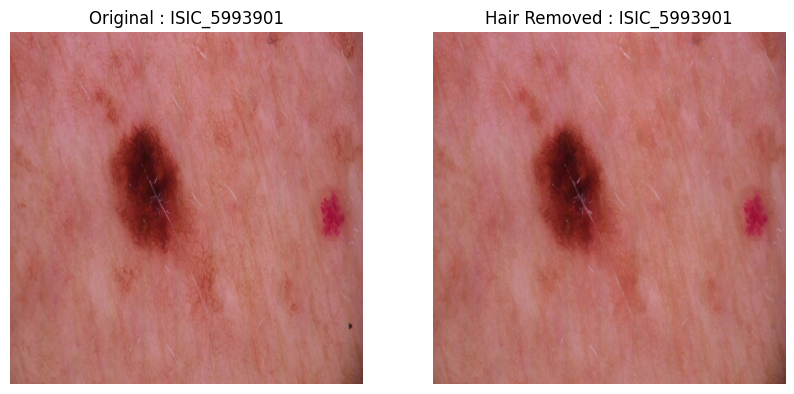

In [35]:
image_list1 = train['path_jpeg'].sample(8).tolist()
for i, image_path in enumerate(image_list1):
    
    fig = plt.figure(figsize=(10,5))
    
    image_name = train.loc[train['path_jpeg'] == image_path, 'image_name'].iloc[0]
    image = cv2.imread(image_path)
    image_resize = cv2.resize(image, (1024, 1024))
    image_resize = cv2.resize(image, (1024, 1024))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image_resize, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Original : '+ image_name)
    
    final_image = remove_hair(image_resize)
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Hair Removed : '+ image_name)
    
plt.show()
